<!--HEADER-->
*Notas de aula de Modelagem Matemática - 2021/1 [- Ricardo M. S. Rosa (IM/UFRJ)](http://www.im.ufrj.br/rrosa)*

<!--BADGES-->
<a href="https://nbviewer.jupyter.org/github/rmsrosa/modelagem_matematica/blob/modmat2021p1/notas_de_aula/09.03-Ondas_sonoras_elementos_musicais.ipynb" target="_blank"><img align="left" src="https://img.shields.io/badge/view%20in-nbviewer-orange" alt="View in NBViewer" title="View in NBViewer"></a><a href="https://mybinder.org/v2/gh/rmsrosa/modelagem_matematica/julia-env-for-binder-2021p1?urlpath=git-pull%3Frepo%3Dhttps%253A%252F%252Fgithub.com%252Frmsrosa%252Fmodelagem_matematica%26branch%3Dmodmat2021p1%26urlpath%3Dtree%252Fmodelagem_matematica%252Fnotas_de_aula/09.03-Ondas_sonoras_elementos_musicais.ipynb" target="_blank"><img align="left" src="https://mybinder.org/badge.svg" alt="Open in binder" title="Open in binder"></a><a href="https://nbviewer.jupyter.org/github/rmsrosa/modelagem_matematica/blob/modmat2021p1/notas_de_aula/slides/09.03-Ondas_sonoras_elementos_musicais.slides.html" target="_blank"><img align="left" src="https://img.shields.io/badge/view-slides-darkgreen" alt="View Slides" title="View Slides"></a>&nbsp;

<!--NAVIGATOR-->
[<- 9.2. Transformada discreta de Fourier](09.02-Transformada_discreta_Fourier.ipynb) | [Página inicial](00.00-Pagina_inicial.ipynb) | [10. Modelos com equações a derivadas parciais ->](10.00-EDP.ipynb)

---


# Ondas sonoras e elementos musicais

In [1]:
using LinearAlgebra
using Plots
using WAV
using FFTW
using Random

┌ Info: Precompiling FFTW [7a1cc6ca-52ef-59f5-83cd-3a7055c09341]
└ @ Base loading.jl:1317


In [2]:
include(joinpath("src", "AudioCaptionDisplay.jl"))
using .AudioCaptionDisplay

## Ondas sonoras e elementos musicais

### Tipos de ondas

* O som que ouvimos é resultado de ondas longitudinais do ar e que chegam até o nosso ouvido.

* Essas ondas são movimentos/vibrações coordenadas das moléculas do meio.

* Em sólidos e líquidos, as ondas podem ser tanto longitudinais como transversais, como vimos em ondas sísmicas, por exemplo. As ondas transversais dependem da rigidez do meio e, portanto, não ocorrem em gases.

* Ondas longitudinais, por sua vez, dependem da resistência do meio à compressão e podem se propagar em diversos meios.

* Vamos nos concentrar aqui em ondas longitudinais que se propagam no ar e geram o som que ouvimos, ou sejam, são ondas sonoras.

### Características de ondas sonoras

* Ondas sonoras podem ser caracterizadas pelas seguintes propriedades:
  1. **Direção de propagação**;
  1. **Velocidade de propagação**;
  1. **Frequência**, ou o seu recíproco multiplicativo, **comprimento de onda**;
  1. **Intensidade/Pressão/Amplitude**.
  1. **Forma**
* A velocidade é determinada pelo meio. Como estamos nos restringindo ao ar atmosférico em condições normais de temperatura e pressão, vamos considerar essa velocidade constante.
* E como não estamos interessados na propagação da onda em si, mas sim no seu efeito na audição, a direção de propagação também não é relevante.
* Vamos nos ater, então, às outras três características: **frequência**, **intensidade** e **forma**.

### Elementos musicais

* Os elementos musicais diretamente relacionados às características selecionadas acima são
  1. **Altura** *(pitch)*, determinada pela *frequência* da onda, que determina, no final das contas, as notas musicais.
  1. **Dinâmica**, que está relacionada à intensidade/amplitude da onda, ou ao que chamamos comumente de "volume".
  1. **Timbre**, que está relacionado com a forma da onda e caracteriza diferentes instrumentos musicais.
  
* Há diversos outros elementos musicais importantes em uma música mas que não vamos nos ater aqui: *tempo*, *duração* (de cada nota), *textura* (quantidade/complexidade de sons), *articulação* (suavidade ou não da combinação de notas)  

### Reproduzindo sons no Julia

* Vamos usar o pacote [dancasimiro/WAV.jl](https://github.com/dancasimiro/WAV.jl) para reproduzir sons digitais codificados na forma de uma vetor (ou matriz, de tiver mais canais)

* Os sons digitalizados, em forma de vetores ou arrays, podem ser reproduzidos pelo `WAV.jl` através das funções `wavplay`, `wavwrite`, ou da exibição do struct `WAVArray`. A vantagem do `WAVArray` no caderno Jupyter (ou no REPL) é que ele cria um elemento html de áudio, em que se pode reproduzir o som clicando-se no elemento, além de outras possibilidade de interação.

* Aqui, vamos usar uma modificação do `WAVArray`, denominada `CWAVArray`, que inclui um texto de "caption", para facilitar a indicação do áudio associado ao elemento html.

* Esse struct `CWAVArray` está no módulo `AudioCaptionDisplay` no arquivo local `src/AudioCaptionDisplay.jl`.

* Qualquer uma dessas formas inclui não só o vetor, ou matriz, com as intensidades, mas também uma número em ponto flutuante indicando a taxa de amostragem.

In [3]:
?wavplay

search: wavplay



```
wavplay(data, fs)
wavplay(filename::AbstractString)
```

Plays the audio waveform `data` at sampling frequency `fs` (in hertz). To play a stereo signal, provide two columns in array `data` (left and right channel), as in [`wavwrite`](@ref).

The `filename` form reads both waveform data and sampling frequency from the named WAV file to play it.

The supported backends are:

  * AudioQueue (macOS)
  * PulseAudio (Linux, libpulse-simple)
  * PlaySound  (Windows)

See also: [`wavwrite`](@ref)


## Frequências e notas musicais

* Para a construção das notas, vamos considerar funções definidas em $\mathbb{R}$ (na verdade, para qualquer ponto flutuante...) que sejam periódicas de período 1.

* Assim, se $f=f(t)$ é uma função periódica de período $1$ e $\nu > 1$, então $f(\nu t)$ é uma função periódica de período $1/\nu$ e frequência $\nu$.

* As funções fundamentais para isso são as sinusoidais, $\cos(2\pi t)$ e $\sin(2\pi t)$, ou translações dela, onde a translação é a fase $\varphi$, e que podemos escrever de forma mais geral como
$$ \sin(\varphi + 2\pi t) \quad \text{ou} \quad \cos(\varphi + 2\pi t).
$$

* Abaixo, vamos considerar simplesmente $\sin(2\pi t)$.

* Podemos ter outras funções, com formas retangulares, triangulares, serra, etc.

* As notas são dadas pela frequência $\nu$, enquanto que a "cor" da nota (e.g. piano, violão, saxofone, etc.) é dada pela forma da onda.

### Resolução

* Como o ouvido humado pode sentir sons de até $20.000 \,\texttt{Hz}$, devemos usar uma discretização temporal suficientemente mais fina para uma boa "resolução" dessas frequências audíveis.

* Em digitalizações de áudio, é comum se utilizar a resolução de [$44.100\,\texttt{Hz}$](https://en.wikipedia.org/wiki/44,100_Hz).

* Isso é devido ao [Teorema de Nyquist–Shannon](https://en.wikipedia.org/wiki/Nyquist–Shannon_sampling_theorem) e está ligado ao fenômeno de [*aliasing*](https://en.wikipedia.org/wiki/Aliasing).

* É necessária uma resolução maior do que o dobro da maior frequência a ser sampleada, caso contrário, a mesma série de dados pode representar ondas de diferentes frequências.

* Inicialmente, outras frequências de sampleamento foram sugeridas e utilizadas, em particular levando a disputas entre companhias como Sony e Philips, prevalecendo a escolha de $44.1\,\texttt{KHz}$, que tem sido mantida até hoje, em diversas mídias e formatos.

In [4]:
fs = 44100.0 # frequência de sampleamento 44.1 kHz
Tf = 1.0 # intervalo de tempo pro sampleamento
t = 0.0:inv(fs):Tf # malha temporal, com sampleamento de intervalo 1/fs segundos
nothing

In [5]:
ν = 20 # 20Hz
A = 1
g = A * sin.(2π * ν * t)
nothing

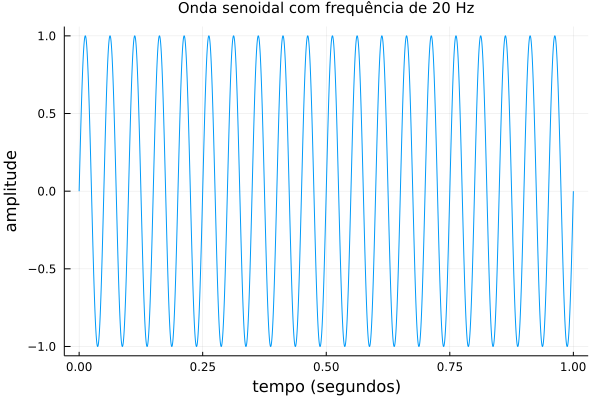

In [6]:
plot(t, g, xaxis = "tempo (segundos)", yaxis = "amplitude", label=nothing,
    title="Onda senoidal com frequência de $ν Hz", titlefont=10)

### Reproduzindo frequências baixas

* Apesar de conseguirmos ouvir frequências a partir de $20\,\texttt{Hz}$, não conseguimos, em geral, produzir sons com frequências tão baixas assim (mas há exceções).

* Em geral, produzimos sons a partir de $85\,\texttt{Hz}$, até uns $3\,\texttt{kHz}$.

* Mesmo equipamentos de som nem sempre conseguem produzir sons tão baixos.

* Vejamos na experiência abaixo (no computador que utilizo, identifico o som a partir de $20\,\texttt{Hz}$ no fone-de-ouvido, mas só a partir dos $80\,\texttt{Hz}$ na saída de som do computador).

In [7]:
for ν in 20:20:120
    g = sin.(2π * ν * t)
    display(CWAVArray(fs, g, "ν=$ν Hz:"))
end

CWAVArray{Float64, 1}(44100.0, [0.0, 0.002849513289887915, 0.005699003442461746, 0.008548447320595277, 0.011397821787538034, 0.014247103707103134, 0.01709626994385516, 0.01994529736329802, 0.022794162832062766, 0.025642843218095453  …  -0.025642843218095276, -0.022794162832072626, -0.019945297363303707, -0.017096269943856678, -0.014247103707114685, -0.011397821787545412, -0.008548447320598484, -0.005699003442460779, -0.0028495132898969863, -4.898587196589413e-15], "ν=20 Hz:")

CWAVArray{Float64, 1}(44100.0, [0.0, 0.005699003442461746, 0.011397821787538034, 0.01709626994385516, 0.022794162832062766, 0.028491315390844964, 0.034187542582930976, 0.03988265940110491, 0.04557648087421461, 0.051268822073179295  …  -0.05126882207317894, -0.04557648087423431, -0.03988265940111628, -0.03418754258293401, -0.02849131539086806, -0.02279416283207752, -0.017096269943861576, -0.011397821787536101, -0.005699003442479889, -9.797174393178826e-15], "ν=40 Hz:")

CWAVArray{Float64, 1}(44100.0, [0.0, 0.008548447320595277, 0.01709626994385516, 0.02564284321809545, 0.034187542582930976, 0.04272974361491678, 0.05126882207317929, 0.05980415394503416, 0.06833511549158741, 0.07686108329331656  …  -0.07686108329337271, -0.06833511549161693, -0.05980415394509376, -0.05126882207321222, -0.042729743614979804, -0.03418754258296731, -0.025642843218161897, -0.017096269943894894, -0.008548447320665122, -4.3117471020172244e-14], "ν=60 Hz:")

CWAVArray{Float64, 1}(44100.0, [0.0, 0.011397821787538034, 0.022794162832062766, 0.034187542582930976, 0.04557648087421461, 0.056959498116995876, 0.06833511549158741, 0.07970185513965247, 0.09105824035620028, 0.10240279578143142  …  -0.10240279578143072, -0.09105824035623955, -0.07970185513967516, -0.06833511549159346, -0.05695949811704201, -0.045576480874244096, -0.0341875425829438, -0.0227941628320589, -0.011397821787574317, -1.9594348786357652e-14], "ν=80 Hz:")

CWAVArray{Float64, 1}(44100.0, [0.0, 0.014247103707103134, 0.028491315390844964, 0.04272974361491678, 0.056959498116995876, 0.0711776903954407, 0.08538143429562847, 0.09956784659581666, 0.11373404759240871, 0.127877161684506  …  -0.12787716168444876, -0.1137340475924577, -0.0995678465958591, -0.08538143429566435, -0.07117769039546995, -0.05695949811701853, -0.0427297436149328, -0.02849131539085434, -0.014247103707105859, 3.928773447456944e-15], "ν=100 Hz:")

CWAVArray{Float64, 1}(44100.0, [0.0, 0.01709626994385516, 0.034187542582930976, 0.05126882207317929, 0.06833511549158741, 0.08538143429562847, 0.10240279578143141, 0.11939422454024433, 0.1363507539127653, 0.15326742744091587  …  -0.15326742744102717, -0.13635075391282392, -0.11939422454036287, -0.10240279578149701, -0.08538143429575418, -0.06833511549165995, -0.05126882207331205, -0.0341875425830104, -0.017096269943994838, -8.623494204034449e-14], "ν=120 Hz:")

### Reproduzindo frequências altas

* Da mesma forma, em geral, só conseguimos produzir som com as nossas cordas vocais até uns $3\,\texttt{kHz}$.

* E equipamentos de som também não conseguem produzir sons tão altos quanto $20.000\,\texttt{Hz}$.

* Vejamos a experiência abaixo (no meu laptop, identifico o som até uns $12.000\,\texttt{Hz}$).

In [8]:
for ν in 10000:1000:16000
    g = sin.(2π * ν * t)
    display(CWAVArray(fs, g, "ν=$ν Hz:"))
end

CWAVArray{Float64, 1}(44100.0, [0.0, 0.9893554255245747, 0.28794045010251906, -0.9055536888925841, -0.5514913743150942, 0.7450485049605833, 0.7683291217331284, -0.5214352033794981, -0.9200868048537143, 0.2536545839095076  …  -0.253654583907442, 0.9200868048540985, 0.5214352033796449, -0.7683291217322793, -0.7450485049622372, 0.5514913743120634, 0.9055536888915282, -0.28794045010379815, -0.9893554255245482, -9.71364707913698e-13], "ν=10000 Hz:")

CWAVArray{Float64, 1}(44100.0, [0.0, 0.9999936564536084, 0.007123732611891803, -0.999942908565361, -0.014247103707103815, 0.9998414153642309, 0.021369751787303017, -0.9996891820008162, -0.028491315390846327, 0.9994862162006878  …  -0.9994862162008924, 0.02849131538246939, 0.9996891820010749, -0.021369751774932253, -0.9998414153644868, 0.014247103690739523, 0.9999429085654017, -0.0071237326060851055, -0.9999936564536361, -9.79965031572518e-12], "ν=11000 Hz:")

CWAVArray{Float64, 1}(44100.0, [0.0, 0.990366961494838, -0.2742675106749304, -0.9144126230158125, 0.5275005885087648, 0.7683291217331284, -0.7402779970753155, -0.563320058063623, 0.8962811717017866, 0.3151082180236217  …  -0.3151082180232903, -0.8962811717064272, 0.5633200580586422, 0.740277997076385, -0.7683291217349492, -0.527500588514941, 0.9144126230146655, 0.27426751067338884, -0.9903669614936594, -4.076020695169808e-12], "ν=12000 Hz:")

CWAVArray{Float64, 1}(44100.0, [0.0, 0.9606704261456819, -0.5335392039273009, -0.6643522775070463, 0.9025085982392753, 0.16311511444160862, -0.9930998207221546, 0.3884347962746957, 0.7773700695591511, -0.8201722545969564  …  0.8201722545937027, -0.7773700695604121, -0.38843479627624167, 0.9930998207215258, -0.16311511444704246, -0.9025085982384888, 0.6643522775056582, 0.5335392039319857, -0.960670426147162, 1.647608925385563e-12], "ν=13000 Hz:")

CWAVArray{Float64, 1}(44100.0, [0.0, 0.9115058523116732, -0.749781202967734, -0.2947551744109047, 0.9922392066001722, -0.5214352033794981, -0.563320058063623, 0.984807753012208, -0.24675739769029226, -0.7818314824680302  …  0.7818314824662644, 0.24675739769037208, -0.9848077530142714, 0.563320058056077, 0.5214352033849432, -0.9922392065997206, 0.29475517441006305, 0.7497812029761255, -0.9115058523075886, -7.180676682425918e-12], "ν=14000 Hz:")

CWAVArray{Float64, 1}(44100.0, [0.0, 0.8438695627580834, -0.9055536888925841, 0.12787716168450614, 0.7683291217331284, -0.9523686484908523, 0.2536545839095076, 0.6801727377709194, -0.9835457412105524, 0.3752670048793753  …  -0.37526700487640535, 0.983545741210944, -0.6801727377653966, -0.2536545839079118, 0.9523686484919863, -0.7683291217366255, -0.12787716168441055, 0.905553688894821, -0.8438695627601819, -1.457047061870547e-12], "ν=15000 Hz:")

CWAVArray{Float64, 1}(44100.0, [0.0, 0.7591322105748435, -0.988293681537243, 0.527500588508764, 0.30155494042175085, -0.9200868048537143, 0.8962811717017858, -0.24675739769029226, -0.5750343933241155, 0.9953791129491986  …  -0.9953791129486879, 0.5750343933206362, 0.24675739769338073, -0.8962811717091809, 0.9200868048476, -0.3015549404078829, -0.5275005885202161, 0.9882936815391371, -0.7591322105674552, -1.0285332669682027e-11], "ν=16000 Hz:")

### As notas musicais

* As **notas musicais** são obtidas a partir de ondas com determinadas frequências.

* O nosso ouvido, de uma maneira ou de outra, sente certas combinações de notas de maneira mais agradável do que outras.

* A divisão dessas notas/frequências em cada música ou conjunto de músicas nos leva ao conceito de **escala musical**.

* Há várias escalas conhecidas, como as **diatônicas** (sete notas), **pentatônicas** (cinco notas) e a **cromática** (doze).

* Em certas escalas, podemos considerar diversos **modos**, que são conjuntos menores de notas da escala, definidos pela relação entre duas notas consecutivas.

* Por exemplo, os modos eólio, dórico, frígio, lídio, mixolidio, jônio e lócrio são modos diatônicos.

* As escalas maiores e menores são exemplos de escalas diatônicas nos modos eólio e jônio, respectivamente.

* As escalas pentatônicas também possuem modos menor e maior.

* Juntando as notas de todas as escalas diatônicas, obtemos um conjunto de doze notas, que formam a escala cromática.

### Oitavas

* As escalas se repetem em **oitavas**. Cada nota de uma oitava tem o dobro da frequência da mesma nota na oitava anterior.

* A partir das menores frequências que podemos ouvir, distinguir e produzir com a voz ou com instrumentos ($\sim 20,\texttt{Hz}$), as oitavas são denotadas numericamente, 0, 1, 2, ....

* A nota LÁ, por exemplo, é também denotada pela letra $A$, e assim temos o LÁ nessas diversas oitavas denotado por $A_0, A_1, A_2, \ldots$.

* Um piano padrão tem 55 teclas, cobrindo um pouco mais de sete oitavas (de $A_0$ a $C_8$).

### Afinação

* Não há nada de especial em uma determinada frequência por si só. É a composição dela com outras que faz sentido musical.

* Nesse aspecto, podemos partir de qualquer frequência para montar uma determinada escala e as suas oitavas.

* Por convenção, a nota $A_4$ tem a frequência de $440\,\texttt{Hz}$ (ou variações disso:  $432, 434, 436, \ldots, 446\,\texttt{Hz}$).

### Nota LÁ em diferentes oitavas

* Como dito acima, as escalas se repetem em oitavas, que são formadas a partir de potências de dois.

* Para uma determinada nota com frequência $\nu$, podemos considerar os seus múltiplos de potências de 2: $2\nu$, $4\nu$, $8\nu$ e assim por diante.

* Vejamos abaixo, a nota LÁ em diferentes oitavas, tanto separadamente como em conjunto.

CWAVArray{Float64, 1}(44100.0, [0.0, 0.03133955622145082, 0.06264832417874369, 0.09389554585439046, 0.1250505236945281, 0.15608265076647385, 0.18696144082725336, 0.2176565582735623, 0.2481378479437379, 0.2783753647424632  …  -0.2783753647425159, -0.2481378479437328, -0.21765655827349853, -0.18696144082713012, -0.15608265076651515, -0.12505052369450995, -0.0938955458543124, -0.06264832417860543, -0.03133955622147954, 3.138066912872848e-14], "A_3 (ν = 220.0)")

CWAVArray{Float64, 1}(44100.0, [0.0, 0.06264832417874369, 0.1250505236945281, 0.18696144082725336, 0.2481378479437379, 0.30833940305910035, 0.36732959406137883, 0.42487666788983847, 0.4807545410165317, 0.5347436876541296  …  -0.5347436876542223, -0.48075454101652254, -0.4248766678897201, -0.36732959406114546, -0.3083394030591799, -0.24813784794370242, -0.1869614408270993, -0.1250505236942532, -0.06264832417880103, 6.276133825745696e-14], "A_4 (ν = 440.0)")

CWAVArray{Float64, 1}(44100.0, [0.0, 0.1250505236945281, 0.2481378479437379, 0.36732959406137883, 0.4807545410165317, 0.5866320022005456, 0.6832997808714387, 0.7692402653962488, 0.8431042546155975, 0.9037321392901134  …  -0.9037321392902075, -0.8431042546155862, -0.7692402653960817, -0.6832997808710723, -0.586632002200681, -0.4807545410164675, -0.3673295940610871, -0.2481378479432011, -0.12505052369464212, 1.2552267651491393e-13], "A_5 (ν = 880.0)")

CWAVArray{Float64, 1}(44100.0, [0.0, 0.2190384040947226, 0.4358366958170097, 0.6481865807430227, 0.8539429126547977, 1.05105405602612, 1.237590815760071, 1.4117734915596496, 1.5719966435758672, 1.7168511916867062  …  -1.7168511916869456, -1.5719966435758415, -1.4117734915593003, -1.237590815759348, -1.0510540560263761, -0.8539429126546798, -0.6481865807424988, -0.4358366958160597, -0.2190384040949227, 2.1966468390109937e-13], "combinação das frequências")

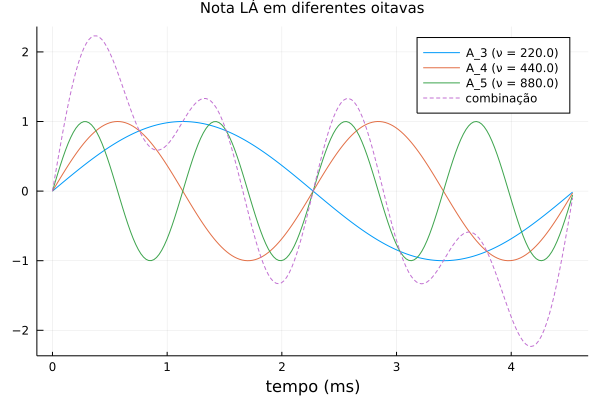

In [9]:
ν₀ = 27.5 # A_0
f = zeros(length(t))
multiples = 3:5
nt = Int(floor(fs/ν₀/2^first(multiples))) + 1 # índice do período do primeiro múltiplo considerado
p = plot(title="Nota LÁ em diferentes oitavas", xlabel="tempo (ms)", titlefont=10)
for n in multiples
    ν = 2^n * ν₀
    g = sin.(2π * ν * t)
    f .+= g
    plot!(p, 1000 * t[1:nt],g[1:nt], label="A_$n (ν = $ν)")
    display(CWAVArray(fs, g, "A_$n (ν = $ν)"))
end
display(CWAVArray(fs, f, "combinação das frequências"))
plot!(p, 1000 * t[1:nt],f[1:nt], label="combinação", linestyle=:dash)
display(p)

### Semitons na escala temperada

* Há, na verdade, diversas maneiras de se definir as notas dentro de uma oitava (veja [Physics of Music: Just vs Equal Temperament](https://pages.mtu.edu/~suits/scales.html).

* A **escala temperada** é obtida por uma *razão uniforme* entre as frequências de notas (semitons, nesse caso) consecutivas.

* Mais precisamente, ao consideramos doze semitons em uma oitava (e.g. escala cromática ou a união das notas de todas as escalas diatônicas), então as frequências $\nu_i, \nu_{i+1}$ de dois semitons consecutivos é definida como sendo constante, $\nu_{i+1} = r\nu_i$.

* Se $\nu$ é a primeira nota, então $\nu_{12} = r^11\nu$ e o tom seguinte completa uma oitava, ou seja $r\nu_{12} = 2\nu$.

* Daí tiramos que $r^{12} = 2$, ou $r = 2^{1/12}$.

### Semitons na escala harmônica

* A **escala harmônica** aparece de forma mais natural, a partir dos harmônicos gerados por uma onda fundamental.

* Em matemática, a série harmônica é conhecida como sendo a série
$$ \sum_n \frac{1}{k^n} = 1 + \frac{1}{2} + \frac{1}{3} + \frac{1}{4} + \ldots.
$$

* Nesse sentido "1" é o "período fundamental".

* Mas em uma corda vibrante, o período fundamental é "2", ou seja, é duas vezes o comprimento da corda.

* Assim, os períodos gerados pela vibração de uma corda tensionada são os múltiplos $2, 2/2, 2/3, 2/4, 2/5, \ldots$, do comprimento da corda, $L$.

* Observe que as frequências são os recíprocos dos comprimentos de onda, $1/2L, 2/2L, 3/2L, 4/2L, 5/2L, \ldots$. 

* Se $\nu=1/2L$ é a frequência base, os seus harmônicos são $\nu, 2\nu, 3\nu, 4\nu, \ldots.$

* Os harmônicos irão produzir notas diferentes da fundamental, mas ainda assim "agradáveis", em geral.

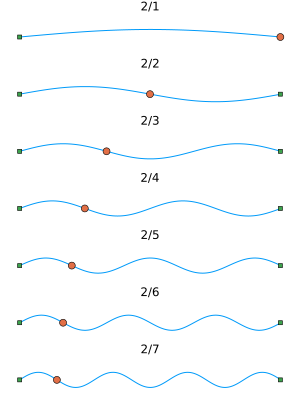

CWAVArray{Float64, 1}(44100.0, [0.0, 0.01567170273176101, 0.03133955622145082, 0.04699971217243888, 0.06264832417874369, 0.07828154866977678, 0.09389554585439046, 0.10948648066399701, 0.1250505236945281, 0.14058385214700292  …  -0.1405838521470301, -0.12505052369452552, -0.10948648066396453, -0.09389554585432801, -0.07828154866979763, -0.06264832417873455, -0.04699971217239972, -0.03133955622138159, -0.015671702731775372, 1.569033456436424e-14], "Comprimento de onda: 2/1 (ν = 110.0)")

CWAVArray{Float64, 1}(44100.0, [0.0, 0.03133955622145082, 0.06264832417874369, 0.09389554585439046, 0.1250505236945281, 0.15608265076647385, 0.18696144082725336, 0.2176565582735623, 0.2481378479437379, 0.2783753647424632  …  -0.2783753647425159, -0.2481378479437328, -0.21765655827349853, -0.18696144082713012, -0.15608265076651515, -0.12505052369450995, -0.0938955458543124, -0.06264832417860543, -0.03133955622147954, 3.138066912872848e-14], "Comprimento de onda: 2/2 (ν = 220.0)")

CWAVArray{Float64, 1}(44100.0, [0.0, 0.046999712172438875, 0.09389554585439044, 0.1405838521470029, 0.18696144082725333, 0.23292580841837857, 0.27837536474246316, 0.32320965745446, 0.3673295940613788, 0.4106376609359381  …  -0.4106376609360132, -0.3673295940614773, -0.3232096574545824, -0.27837536474261004, -0.23292580841855015, -0.18696144082744975, -0.14058385214722413, -0.09389554585463632, -0.046999712172709054, -2.9398950947175535e-13], "Comprimento de onda: 2/3 (ν = 330.0)")

CWAVArray{Float64, 1}(44100.0, [0.0, 0.06264832417874369, 0.1250505236945281, 0.18696144082725336, 0.2481378479437379, 0.30833940305910035, 0.36732959406137883, 0.42487666788983847, 0.4807545410165317, 0.5347436876541296  …  -0.5347436876542223, -0.48075454101652254, -0.4248766678897201, -0.36732959406114546, -0.3083394030591799, -0.24813784794370242, -0.1869614408270993, -0.1250505236942532, -0.06264832417880103, 6.276133825745696e-14], "Comprimento de onda: 2/4 (ν = 440.0)")

CWAVArray{Float64, 1}(44100.0, [0.0, 0.07828154866977678, 0.15608265076647385, 0.23292580841837857, 0.30833940305910035, 0.3818605899477718, 0.45303813884061694, 0.5214352033794981, 0.5866320022005456, 0.6482283953077884  …  -0.6482283953078929, -0.586632002200443, -0.5214352033795527, -0.4530381388408441, -0.3818605899477633, -0.3083394030592731, -0.23292580841829852, -0.15608265076658095, -0.07828154866962171, -3.5235164899794826e-14], "Comprimento de onda: 2/5 (ν = 550.0)")

CWAVArray{Float64, 1}(44100.0, [0.0, 0.09389554585439044, 0.18696144082725333, 0.27837536474246316, 0.3673295940613788, 0.4530381388406169, 0.5347436876541295, 0.6117242991150063, 0.6832997808714386, 0.7488376997127282  …  -0.7488376997128373, -0.6832997808715934, -0.611724299115211, -0.534743687654388, -0.45303813884093147, -0.36732959406175075, -0.27837536474289243, -0.18696144082773858, -0.09389554585492901, -5.879790189435107e-13], "Comprimento de onda: 2/6 (ν = 660.0)")

CWAVArray{Float64, 1}(44100.0, [0.0, 0.10948648066399701, 0.2176565582735623, 0.32320965745446, 0.42487666788983847, 0.5214352033794981, 0.6117242991150064, 0.6946583704589974, 0.7692402653962488, 0.8345732537213026  …  -0.8345732537214084, -0.7692402653960191, -0.6946583704589964, -0.611724299114569, -0.5214352033793319, -0.42487666788998624, -0.3232096574540927, -0.21765655827353292, -0.10948648066341894, 2.2351917967216573e-13], "Comprimento de onda: 2/7 (ν = 770.0)")

CWAVArray{Float64, 1}(44100.0, [0.0, 0.4383228704925587, 0.8736345998164026, 1.3029513816163873, 1.7233438016545803, 2.1319633430816163, 2.5260680710952386, 2.9030472372353593, 3.2604445551844097, 3.5959799142213527  …  -3.59597991422192, -3.2604445551843133, -2.9030472372355254, -2.5260680710950147, -2.1319633430820693, -1.7233438016554068, -1.3029513816163192, -0.8736345998167291, -0.43832287049273466, -5.838521716923455e-13], "combinação")

In [10]:
oitava = 3 # A_3
ν_b = (oitava + 1) * 27.5
num_harm = 6
nt = Int(floor(fs/ν_b/2)) + 1
f = zeros(length(t))
harmonicos = fill(0.0, nt, num_harm + 1)
wav_arrays = []
for n in 0:num_harm
    ν = (n+1) * ν_b
    g = sin.(2π * ν * t)
    f .+= g
    harmonicos[:,n+1] .= g[1:nt]
    push!(wav_arrays, CWAVArray(fs, g, "Comprimento de onda: 2/$(n+1) (ν = $ν)"))
end
push!(wav_arrays, CWAVArray(fs, f, "combinação"))
p = plot(1000 * t[1:nt], harmonicos, layout=(num_harm+1,1), legend=nothing,
    title = hcat(["2/$n" for n in 1:num_harm+1]...), titlefont=8,
    xticks=nothing, yticks=nothing, axis=false, ylims=(-1.1,1.1), size=(300,400))
scatter!(p, 1000 * [t[j] for j in (1,nt), i in 1:num_harm+1], fill(0.0,2,num_harm+1), layout = (num_harm+1,1), marker=:square, markersize=2, color=3)
scatter!(p, 1000 * t[nt] .* hcat(inv.(1:num_harm+1)...), zeros(num_harm), layout=(num_harm+1,1), color=2)
display(p)
for wa in wav_arrays
    display(wa)
end


### Espectro e timbre

* Em uma nota "real", seja de violão, guitarra, baixo, contrabaixo, violino, piano, etc., esses harmônicos estão presentes, cada um com uma determinada amplitude.

* Essa combinação de amplitudes compõe o **espectro** da nota e caracteriza a **forma** da onda e o **timbre** do instrumento.

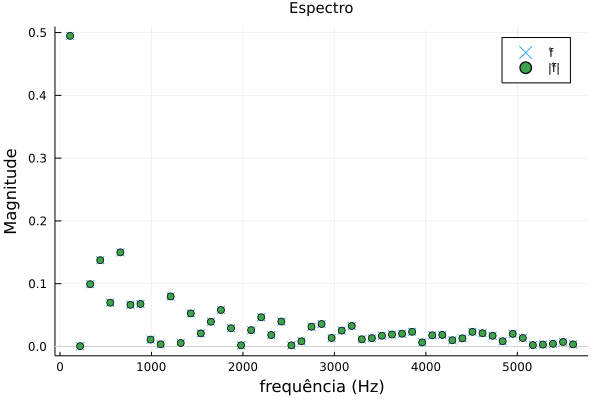

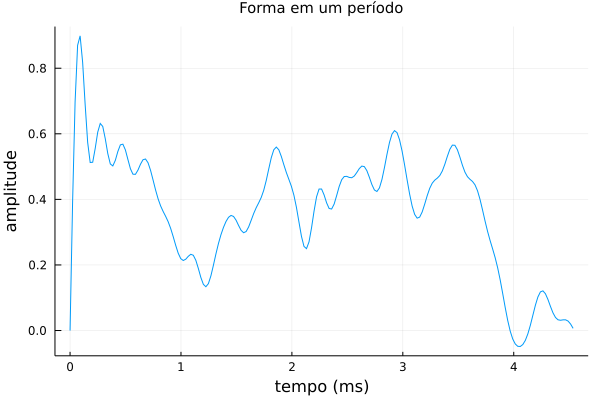

WAVArray{Float64, 2}(44100.0, [0.0; 0.3891678144889097; … ; -0.38916781448929844; -1.6390499232467122e-13])

In [11]:
oitava = 3
ν_b = (oitava + 1) * 27.5
nt = Int(floor(fs/ν_b/2)) + 1
num_harm = 50
f̂ = rand(MersenneTwister(220), num_harm+1) .* inv.(1:num_harm+1)
f = sum([sin.(2π * ν * τ) for τ in t, ν in ν_b * (1:num_harm+1)] .* f̂', dims=2)

p_freq = scatter(ν_b * (1:num_harm+1), f̂, label="f̂", marker=:xcross,
    xaxis = "frequência (Hz)", yaxis = "Magnitude", title="Espectro", titlefont=10)
hline!(p_freq,[0], label=nothing, color=:lightgray)
scatter!(p_freq, ν_b * (1:num_harm+1), abs.(f̂), label="|f̂|")
display(p_freq)

p_forma_per = plot(1000 * t[1:nt], f[1:nt], label=nothing,
    xlabel="tempo (ms)", ylabel="amplitude", title="Forma em um período", titlefont=10)
display(p_forma_per)

WAVArray(fs, f)

### Envelope e dinâmica

* Em um instrumento real, além da combinação de harmônicos em uma nota, temos a sua **dinâmica**.

* Essa dinâmica se refere à variação de **volume**, que cresce rapidamente no início (o "ataque") e depois decai.

* Isso pode ser recriado digitalmente através de uma função **envelope**, positiva, que multiplica a onda.

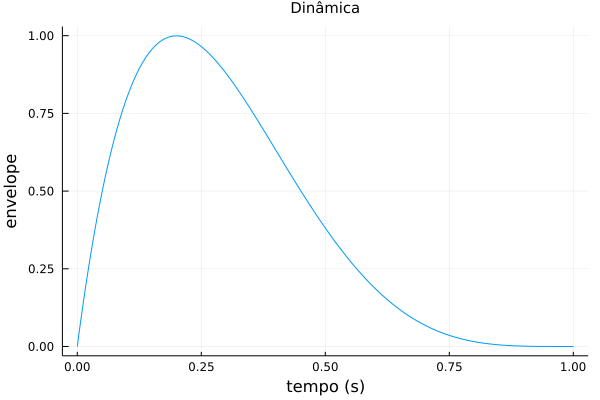

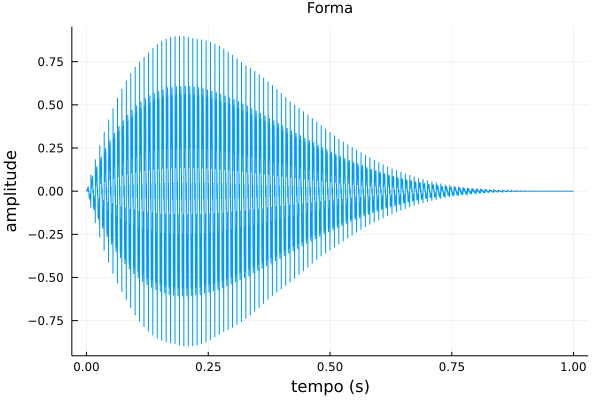

WAVArray{Float64, 2}(44100.0, [0.0; 0.00010765117250936182; … ; -1.255256677058002e-18; -0.0])

In [12]:
dinamica = 12.2 * t .* (t .- 1).^4
fd = dinamica .* f

p_dim = plot(t, dinamica, xaxis="tempo (s)", yaxis="envelope",
        title="Dinâmica", titlefont=10, label=nothing)
display(p_dim)

p_forma = plot(t, fd, label=nothing,
    xlabel="tempo (s)", ylabel="amplitude", title="Forma", titlefont=10)
display(p_forma)
WAVArray(fs, fd)

### Notas reais

* Instrumentos reais, na verdade, são muito mais complexos.

* Abaixo, alguns exemplos

* Violão: [Roland SC-88 Nylon String Guitar C4](https://freewavesamples.com/roland-sc-88-nylon-string-guitar-c4)

* Banjo: [Yamaha MU90R Banjo Man C4](https://freewavesamples.com/yamaha-mu90r-banjo-man-c4)

* Sino em um sintetizador: [Korg DW-8000 Hollow Bell C4](https://freewavesamples.com/korg-dw-8000-hollow-bell-c4)

* Harpa: [Korg M3R Harp C3](https://freewavesamples.com/korg-m3r-harp-c3)

In [13]:
soundnames = (
    "Roland-SC-88-Nylon-String-Guitar-C4",
    "Korg-DW-8000-Hollow-Bell-C4",
    "Yamaha-MU90R-Banjo-Man-C4",
    "Korg-M3R-Harp-C3"
    )
for soundname in soundnames
    filepath = joinpath("data", "audio", soundname * ".wav")
    display(wavread(filepath) |> x -> CWAVArray(x[2], x[1], soundname))
end

CWAVArray{Float64, 2}(44100.0f0, [-0.0003967406231879635 -6.103701895199438e-5; -0.0004577776421399579 -0.0003662221137119663; … ; 3.051850947599719e-5 0.0; -6.103701895199438e-5 -6.103701895199438e-5], "Roland-SC-88-Nylon-String-Guitar-C4")

CWAVArray{Float64, 2}(44100.0f0, [0.0 0.0; 0.0029297769096957305 0.0022583697012237922; … ; -6.103701895199438e-5 0.0; 0.0 0.0], "Korg-DW-8000-Hollow-Bell-C4")

CWAVArray{Float64, 2}(44100.0f0, [0.0027466658528397473 0.002685628833887753; 0.003326517532883694 0.003204443494979705; … ; 3.051850947599719e-5 3.051850947599719e-5; -3.051850947599719e-5 0.0], "Yamaha-MU90R-Banjo-Man-C4")

CWAVArray{Float64, 2}(44100.0f0, [-3.051850947599719e-5 -0.00015259254737998596; 3.051850947599719e-5 0.00021362956633198035; … ; 3.051850947599719e-5 -6.103701895199438e-5; -9.155552842799158e-5 0.0], "Korg-M3R-Harp-C3")

### Análise da onda de cada áudio

CWAVArray{Float64, 2}(44100.0f0, [-0.0003967406231879635 -6.103701895199438e-5; -0.0004577776421399579 -0.0003662221137119663; … ; 3.051850947599719e-5 0.0; -6.103701895199438e-5 -6.103701895199438e-5], "Roland-SC-88-Nylon-String-Guitar-C4")

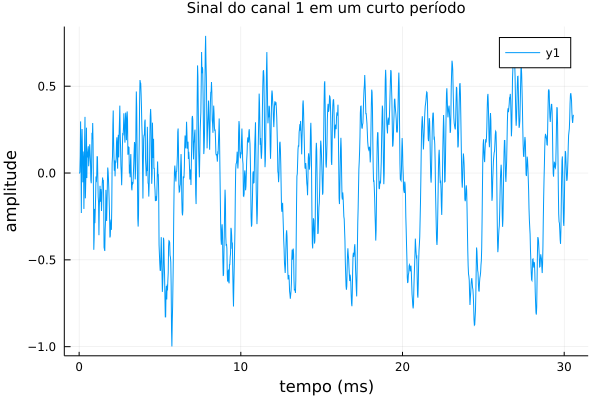

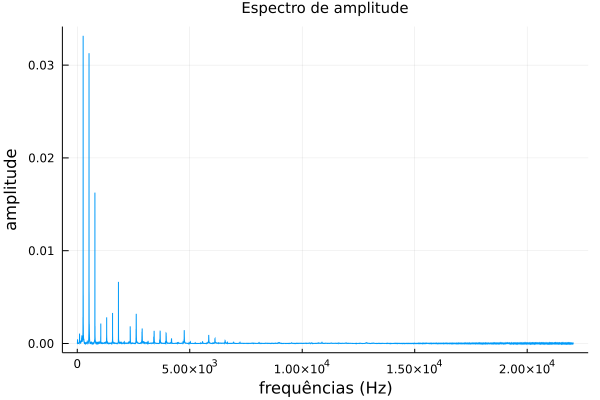

CWAVArray{Float64, 2}(44100.0f0, [0.0 0.0; 0.0029297769096957305 0.0022583697012237922; … ; -6.103701895199438e-5 0.0; 0.0 0.0], "Korg-DW-8000-Hollow-Bell-C4")

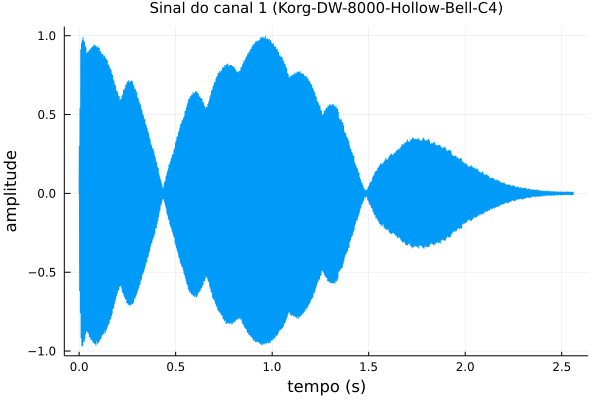

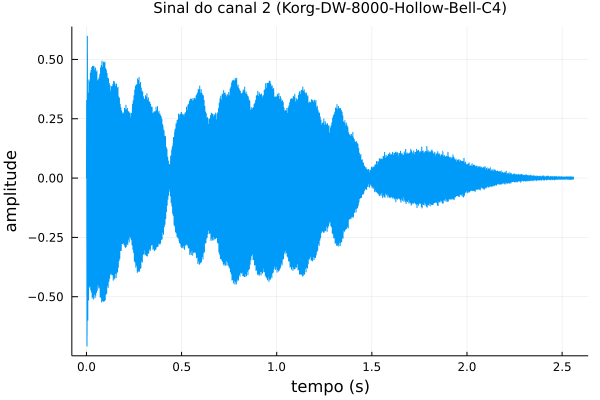

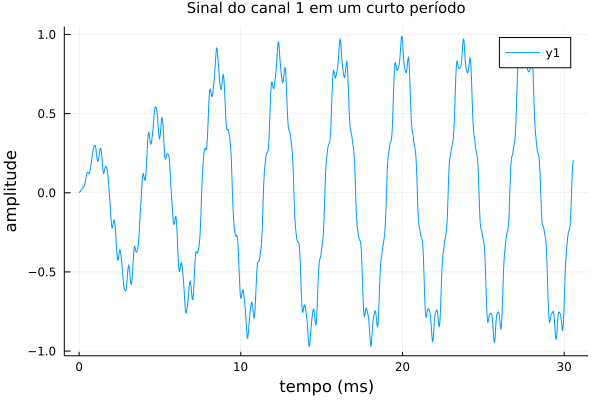

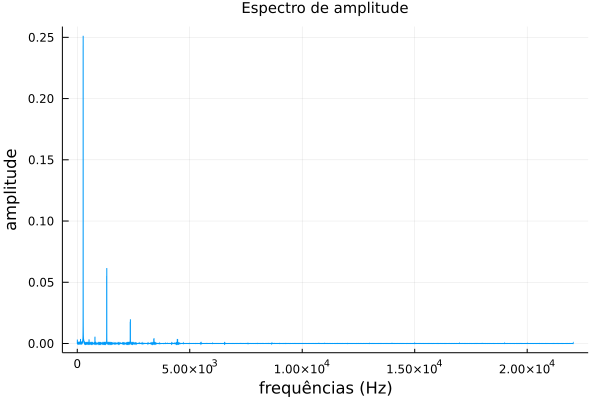

CWAVArray{Float64, 2}(44100.0f0, [0.0027466658528397473 0.002685628833887753; 0.003326517532883694 0.003204443494979705; … ; 3.051850947599719e-5 3.051850947599719e-5; -3.051850947599719e-5 0.0], "Yamaha-MU90R-Banjo-Man-C4")

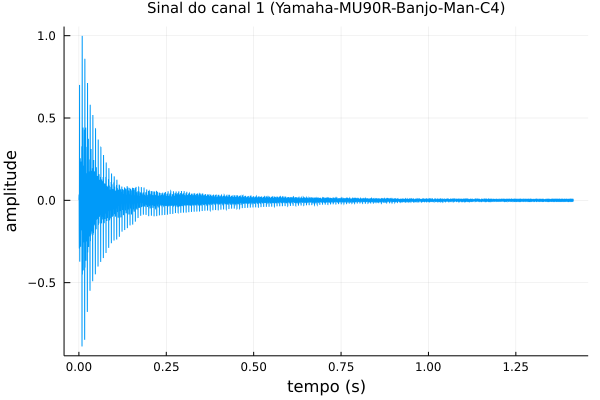

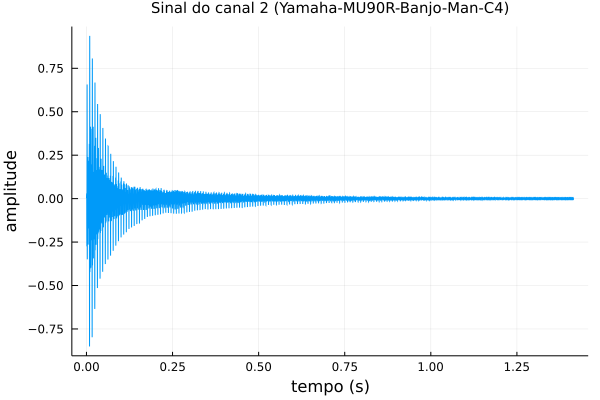

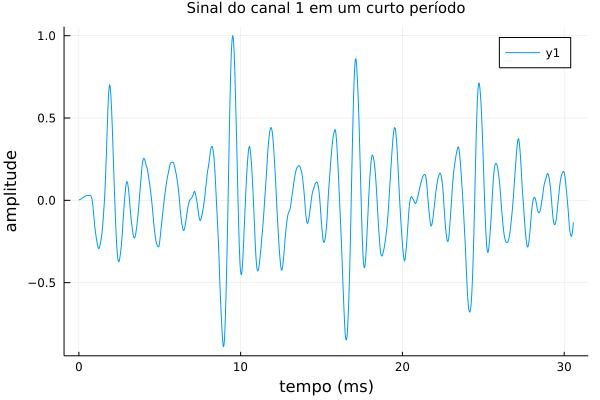

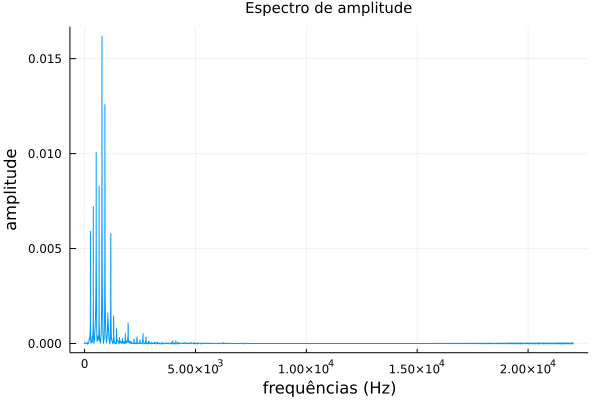

CWAVArray{Float64, 2}(44100.0f0, [-3.051850947599719e-5 -0.00015259254737998596; 3.051850947599719e-5 0.00021362956633198035; … ; 3.051850947599719e-5 -6.103701895199438e-5; -9.155552842799158e-5 0.0], "Korg-M3R-Harp-C3")

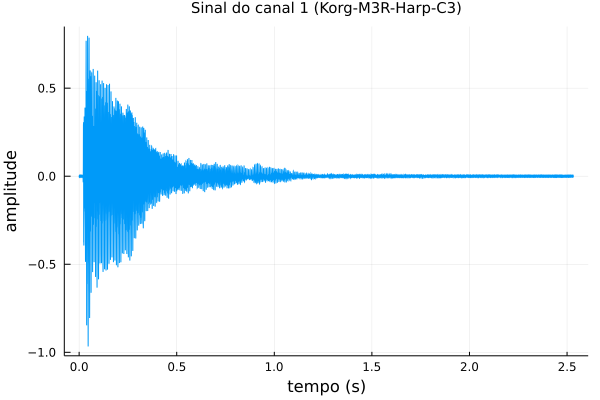

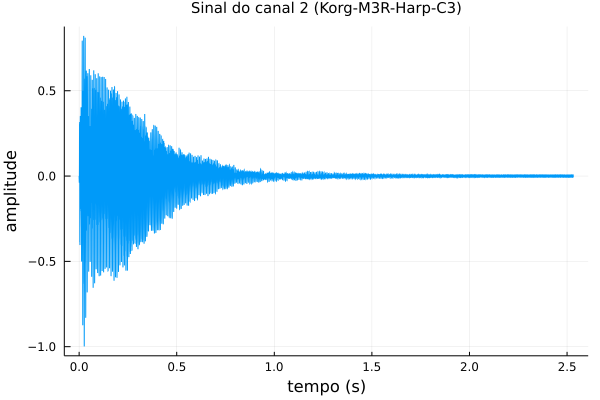

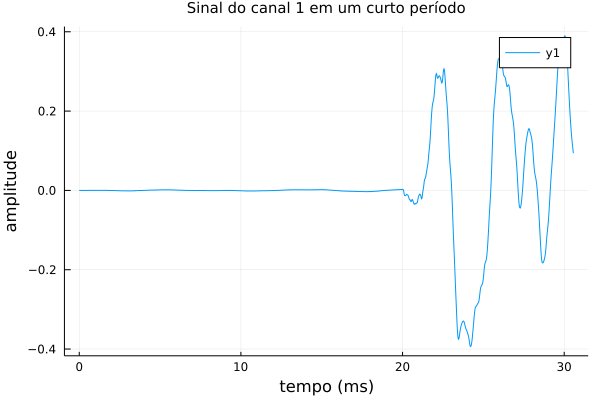

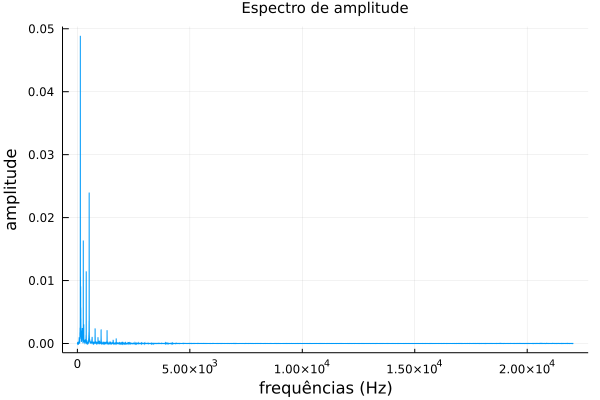

In [14]:
for soundname in soundnames
    filepath = joinpath("data", "audio", soundname * ".wav")
    fr, frs = wavread(filepath)
    Tf = (size(fr)[1]-1)/frs
    tr = (0:size(fr)[1]-1)./frs # intervalo de tempo
    N = length(tr) # N = fs + 1 se T == 1
    freqs = (0:div(N,2))/Tf # frequências
    Xr = rfft(fr[:,1]) # fft real do primeiro canal
    Z = [abs(Xr[1])/N; 2abs.(Xr[2:end])/N]
    ν₀ = 16.35 # C0
    nt = Int(floor(frs/ν₀/2)) + 1
    
    display(CWAVArray(frs, fr, soundname))

    display(plot(tr, fr[:,1], xlabel="tempo (s)", ylabel="amplitude", label=nothing,
        title="Sinal do canal 1 ($soundname)", titlefont=10))
    display(plot(tr, fr[:,2], xlabel="tempo (s)", ylabel="amplitude", label=nothing,
        title="Sinal do canal 2 ($soundname)", titlefont=10))
    display(plot(1000 * tr[1:nt], fr[1:nt,1], xlabel="tempo (ms)", ylabel="amplitude",
        title="Sinal do canal 1 em um curto período", titlefont=10))
    display(plot(freqs, Z, xlabel="frequências (Hz)", ylabel="amplitude", label=nothing,
        title="Espectro de amplitude", titlefont=10))
end

### Examinando o espectro das frequências iniciais

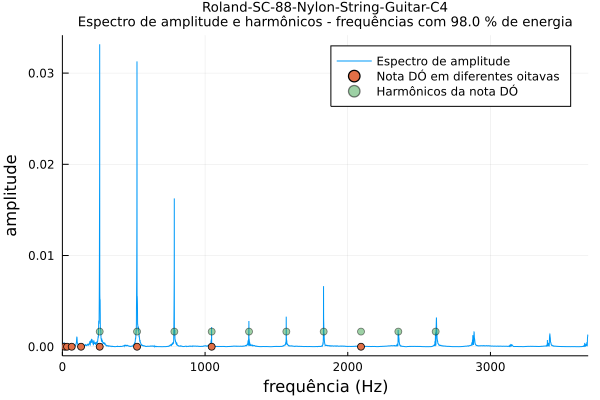

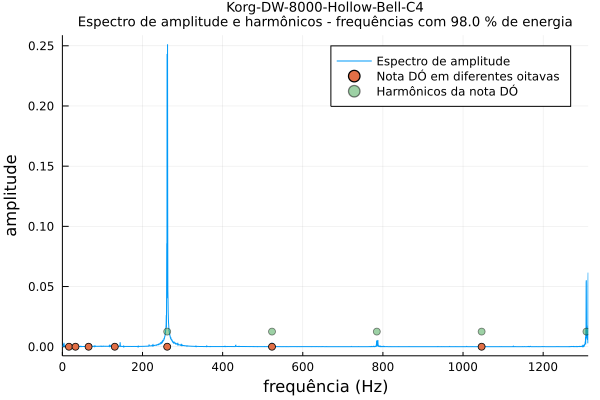

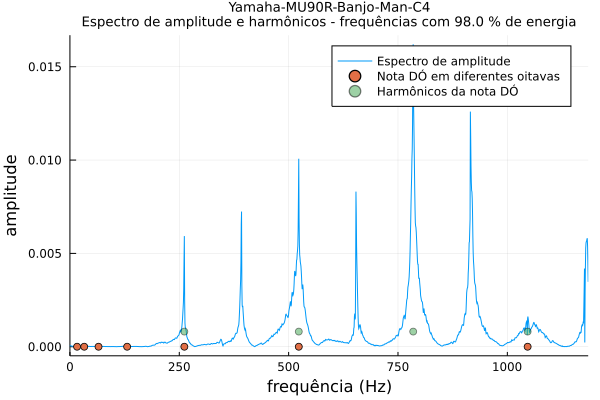

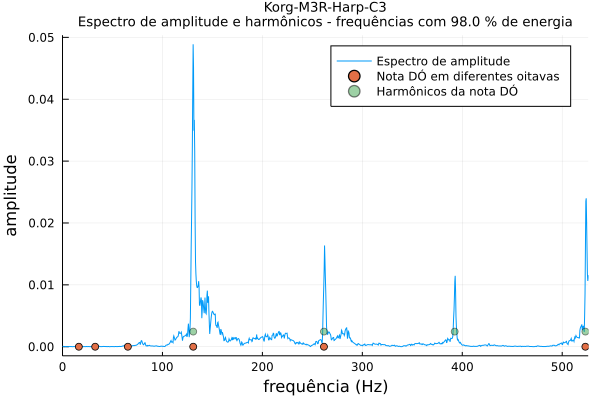

In [15]:
for (soundname, oitava) in zip(soundnames, (4,4,4,3))
    filepath = joinpath("data", "audio", soundname * ".wav")
    fr, frs = wavread(filepath)
    Tf = (size(fr)[1]-1)/frs
    tr = (0:size(fr)[1]-1)./frs # intervalo de tempo
    N = length(tr) # N = fs + 1 se T == 1
    freqs = (0:div(N,2))/Tf # frequências
    Xr = rfft(fr[:,1]) # fft real do primeiro canal
    Z = [abs(Xr[1])/N; 2abs.(Xr[2:end])/N] # amplitudes
    
    npre = 0
    npos = length(Z)
    en = 0.0
    fraction = 0.98
    threshold = fraction * sum(abs2,Z)
    while npos > npre + 1
        naux = npre + div(npos - npre, 2)
        enaux = en + sum(abs2, @view Z[npre+1:naux])
        if enaux > threshold
            npos = naux
        else
            npre = naux
            en = enaux
        end
    end
    
    ν₀ = 16.35 # C0
    ν_b = ν₀ * 2^oitava
    plot(freqs[1:npos], Z[1:npos], xlims=(freqs[1], freqs[npos]), label="Espectro de amplitude", xlabel="frequência (Hz)",
        ylabel="amplitude", title="$(soundname)\nEspectro de amplitude e harmônicos - frequências com $(100*fraction) % de energia", titlefont=9)
    scatter!(ν₀ * 2 .^(0:7), zeros(8), label="Nota DÓ em diferentes oitavas")
    display(scatter!(ν_b * (1:10), maximum(Z)/20 * ones(10), alpha=0.5, label="Harmônicos da nota DÓ"))
end

## Referências

1. [The Physics of Sound](https://homepages.wmich.edu/~hillenbr/206/ac.pdf).

1. [Physics of Music](https://pages.mtu.edu/~suits/Physicsofmusic.html)

1. [Understanding Music Theory](https://www.earmaster.com/music-theory-online/course-introduction.html)

1. [Free Wave Samples](https://freewavesamples.com)

<!--NAVIGATOR-->

---
[<- 9.2. Transformada discreta de Fourier](09.02-Transformada_discreta_Fourier.ipynb) | [Página inicial](00.00-Pagina_inicial.ipynb) | [10. Modelos com equações a derivadas parciais ->](10.00-EDP.ipynb)